<h1><center>Addressing Food Access Challenges: A Data-Driven Approach</center></h1>

## Introduction 

<br>

<div style="text-align: justify">In today's healthcare landscape, it is crucial for national Medicare Advantage plans to understand and address the various social determinants of health affecting their membership. One pressing challenge is the limited access to nutritious and affordable food, commonly known as food insecurity.</div>

<br>

<div style="text-align: justify">The objective of this analysis is to provide actionable insights to the Chief Medical Officer regarding the deployment of a food access program that maximizes the impact on the Medicare Advantage plan's membership. By leveraging publicly available data, we aim to answer key questions related to program deployment, estimated reach, target population, and projected impact.</div>

<br>

<div style="text-align: justify">In the following sections, we will outline the data sources used, describe the methodology employed for analysis, and present our findings and recommendations.</div>

## Data Sources

<br>

<div style="text-align: justify">This analysis relies on two publicly available data sources to gain insights into food access challenges and inform the decision-making process.</div>

**CDC - 500 Cities Project [<a href="https://chronicdata.cdc.gov/500-Cities/500-Cities-Census-Tract-level-Data-GIS-Friendly-Fo/k86t-wghb">Link</a>] - Source**

<br>

<div style="text-align: justify">500 cities project census tract-level data in GIS-friendly format. This dataset can be joined with census tract spatial data in a geographic information system (GIS) to produce maps of 27 measures at the census tract level. Census tract spatial data also can be downloaded at this site.</div>

**FDA – Food Atlas [<a href="https://www.ers.usda.gov/data-products/food-environment-atlas/data-access-and-documentation-downloads/">Link</a>] - Source**

<br>

<div style="text-align: justify">The current version of the Food Environment Atlas has more than 280 variables, including new indicators on food banks and nutrition assistance program participation rates. All of the data included in the Atlas are aggregated into an Excel spreadsheet for easy download. These data come from a variety of sources and cover varying years and geographic levels. </div>


## Data Preparation and Cleaning

In [1]:
# Import all the necessary libraries
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import folium
from folium.plugins import MarkerCluster
import warnings
from pandas.core.common import SettingWithCopyWarning

warnings.simplefilter(action="ignore", category=SettingWithCopyWarning)

In [2]:
# Read all the necessary datasets
path = "C:/Users/arnav/Downloads/N1 Health Case Study/" # path to the datasets

In [3]:
# Food Environment Atlas Data
fda_data = pd.ExcelFile(path + "FoodEnvironmentAtlas.xls")

In [4]:
# Census Tract Level Data (CDC 500)
cdc_data = pd.read_csv(path + "500_Cities__Census_Tract-level_Data__GIS_Friendly_Format___2019_release.csv")

<div style="text-align: justify">As part of our analysis, we will utilize the FDA Food Atlas Data, which is available in an Excel file format, comprising multiple worksheets. To ensure focused and relevant analysis, we will selectively load and explore the worksheets that are pertinent to our objectives.</div>

In [5]:
# Load necessary sheets from 
access = pd.read_excel(fda_data, sheet_name='ACCESS', dtype={'FIPS': str})
insecurity = pd.read_excel(fda_data, sheet_name='INSECURITY', dtype={'FIPS': str})
county_data = pd.read_excel(fda_data, sheet_name='Supplemental Data - County', dtype={'FIPS': str})
state_data = pd.read_excel(fda_data, sheet_name='Supplemental Data - State', dtype={'FIPS': str})
socioeconomic = pd.read_excel(fda_data, sheet_name='SOCIOECONOMIC', dtype={'FIPS': str})

In [6]:
# Check for null values in the dataframes
access.isnull().sum().sum(), insecurity.isnull().sum().sum(), county_data.isnull().sum().sum(), state_data.isnull().sum().sum(), socioeconomic.isnull().sum().sum()

(588, 0, 0, 0, 14)

<div style="text-align: justify">Upon observation, it is noted that the columns *insecurity*, *county_data*, and *state_data* exhibit no null values. It is important to highlight that the presence of null values in the *access* and *socioeconomic* columns is intentional and not an error. For instance, the *access* column illustrates the DeKalb county of Alaska State, which showcases a '0' percentage change in population for low access to stores from 2010 to 2015, thereby explaining the values in the dataset.</div>

In [7]:
# Total null valuyes in the cdc dataset
cdc_data.isnull().sum().sum()

5062

<div style="text-align: justify">After examining the cdc data, it becomes evident that a considerable number of null values are present. However, it's important to approach this situation with caution. Simply having null values doesn't automatically imply that they should be discarded. We need to delve deeper into the data to gain a better understanding of its suitability for our analysis.</div>

In [8]:
# Identify columns with null values
columns_with_null = cdc_data.columns[cdc_data.isnull().any()]
# Count null values in each column
null_counts = cdc_data[columns_with_null].isnull().sum()

<div style="text-align: justify">To maintain the integrity of the analysis and avoid skewed recommendations, remove columns with significant null values instead of entire rows. By retaining neighborhood information, we strike a balance between preserving data and addressing missing values effectively. This ensures more accurate and unbiased insights.</div>

In [9]:
# Specify the columns to remove
columns_to_remove = ['PAPTEST_CrudePrev', 'PAPTEST_Crude95CI', 'TEETHLOST_CrudePrev', 
                     'TEETHLOST_Crude95CI', 'COREM_CrudePrev', 'COREM_Crude95CI', 'COREW_CrudePrev',
                    'COREW_Crude95CI', 'COLON_SCREEN_CrudePrev', 'COLON_SCREEN_Crude95CI',
                    'MAMMOUSE_CrudePrev','MAMMOUSE_Crude95CI']

In [10]:
# Remove the specified columns from the DataFrame
cdc_data_final = cdc_data.drop(columns_to_remove, axis=1)

## Exploratory Data Analysis

<div style="text-align: justify">For our exploratory data analysis, we will focus on relevant datasets that pertain to the problem at hand. Specifically, we will utilize the access, insecurity, socioeconomic, county_data, and cdc datasets.</div>

<br>

<div style="text-align: justify">To facilitate analysis, we will merge the access, insecurity, and socioeconomic datasets together. Subsequently, we will merge this combined dataset with the cdc dataset to create a comprehensive dataset that includes all the necessary features.</div>
 

In [11]:
# Perform the first merge between access 
merged_df = pd.merge(access, insecurity, on=['FIPS', 'State', 'County'], how='inner')

# Perform the second merge between merged_df and socioeconomic 
acc_in_soc = pd.merge(merged_df, socioeconomic, on=['FIPS', 'State', 'County'], how='inner')

# Final acc_in_soc dataframe
acc_in_soc.head(5)

,FIPS,State,County,LACCESS_POP10,LACCESS_POP15,PCH_LACCESS_POP_10_15,PCT_LACCESS_POP10,PCT_LACCESS_POP15,LACCESS_LOWI10,LACCESS_LOWI15,...,PCT_NHPI10,PCT_65OLDER10,PCT_18YOUNGER10,MEDHHINC15,POVRATE15,PERPOV10,CHILDPOVRATE15,PERCHLDPOV10,METRO13,POPLOSS10
0,01001,AL,Autauga,18428.439685,17496.693038,-5.056026,33.769657,32.062255,5344.427472,6543.676824,...,0.040314,11.995382,26.777959,56580.0,12.7,0,18.8,0,1,0.0
1,01003,AL,Baldwin,35210.814078,30561.264430,-13.204891,19.318473,16.767489,9952.144027,9886.831137,...,0.043343,16.771185,22.987408,52387.0,12.9,0,19.6,0,1,0.0
2,01005,AL,Barbour,5722.305602,6069.523628,6.067799,20.840972,22.105560,3135.676086,2948.790251,...,0.087409,14.236807,21.906982,31433.0,32.0,1,45.2,1,0,0.0
3,01007,AL,Bibb,1044.867327,969.378841,-7.224696,4.559753,4.230324,491.449066,596.162829,...,0.030548,12.681650,22.696923,40767.0,22.2,0,29.3,1,1,0.0
4,01009,AL,Blount,1548.175559,3724.428242,140.568857,2.700840,6.497380,609.027708,1650.959482,...,0.031402,14.722096,24.608353,50487.0,14.7,0,22.2,0,1,0.0


<div style="text-align: justify">Our next objective is to merge the 'acc_in_soc' dataframe with the 'cdc' dataframe. To accomplish this, we will first create a new column in the 'cdc' dataset that contains the county FIPS, matching the values in the 'acc_in_soc' dataset. Finally, we will merge the 'acc_in_soc' and 'cdc' datasets.</div>

In [12]:
# Create TractFIPS_County column using TractFIPS -  Contains the county FIPS
cdc_data_final['TractFIPS_County'] = cdc_data_final['TractFIPS'].astype(str).str[:5].str.rstrip('0')

# Add leading zero to four-digit values in a column
cdc_data_final['TractFIPS_County'] = cdc_data_final['TractFIPS_County'].astype(str).str.zfill(5)

In [13]:
# Perform the merge based on TractFIPS_County and FIPS - Created new dataframe "cdc_fda"
cdc_fda = pd.merge(cdc_data_final, acc_in_soc, left_on='TractFIPS_County', right_on='FIPS', how='inner')

Now, we will check which features in the cdc_fda dataset has the most impact on `FOODINSEC_15_17` column. 

- `FOODINSEC_15_17`: Household food insecurity (%, three-year average), 2015-17
- Essentially, we want to identify the features which should be kept in the data for further analysis

In [14]:
# Calculate the correlation matrix
correlation_matrix = cdc_fda.corr()

# Select the correlation values for the target column
correlation_with_target = correlation_matrix['FOODINSEC_15_17'].abs()

# Sort the correlation values in descending order and get the top 10 features
top_20_features = correlation_with_target.sort_values(ascending=False).head(20)

# Print the top 20 features with the most impact on the target
a = pd.DataFrame(top_20_features).reset_index()

In [15]:
# Specify the columns to select
selected_columns = ['StateAbbr', 'PlaceName', 'PlaceFIPS', 'TractFIPS', 'Place_TractID','TractFIPS_County','Population2010','ACCESS2_CrudePrev','FOODINSEC_15_17',
                    'VLFOODSEC_15_17','CH_VLFOODSEC_14_17','CH_FOODINSEC_14_17','FOODINSEC_12_14','PCT_LACCESS_POP15', 'PCT_LACCESS_NHASIAN15',
                    'LACCESS_NHASIAN15','VLFOODSEC_12_14','PERPOV10','PCH_LACCESS_HHNV_10_15','CHECKUP_CrudePrev', 'PCT_LACCESS_LOWI15',
                    'PCT_LACCESS_MULTIR15','PlaceFIPS','PCT_NHPI10','LACCESS_NHPI15','PERCHLDPOV10',
                    'CHILDPOVRATE15','POVRATE15','PCT_LACCESS_NHPI15', 'Geolocation']

In [16]:
# Create a new dataframe with the selected columns - cdc_fda_features
cdc_fda_features = cdc_fda[selected_columns].copy()

<div style="text-align: justify">The Population data given in CDC dataset is for 2010, to make the analysis a bit more relevant, we have decided to calculate the 2017 population of every county.</div>
<br>
<div style="text-align: justify">Note: The values are estimated and may not be actual population for each location. Consider it an assumption for simplifying analysis.</div>

In [17]:
# Calculate percentage change in population from 2010 to 2017 for each county
county_data['%ChangePop'] = ((county_data['Population_Estimate_2017'] - county_data['2010_Census_Population']) / county_data['2010_Census_Population']) * 100

In [18]:
# Perform the merge based on FIPS and TractFIPS_County
cdc_fda_main = pd.merge(cdc_fda_features, county_data[['FIPS', '%ChangePop']], left_on='TractFIPS_County', right_on='FIPS', how='inner')
# Drop the duplicate FIPS column
cdc_fda_main = cdc_fda_main.drop('FIPS', axis=1)

In [19]:
# Create Population2017 column 
cdc_fda_main['Population2017'] = cdc_fda_main['Population2010'] + ((cdc_fda_main['%ChangePop']/100)*cdc_fda_main['Population2010'])
cdc_fda_main['Population2017'] = cdc_fda_main['Population2017'].astype(int) # convert to int type (whole numbers)

To help us answer the question of case study, we are going to create few essential features:

`MedCAccess`: Population with health insurance

`MA_POP`: Estimated Popuplation with Medical Advantage Plan

`MA_POP_FInsec`: Estimated Medical Advantage Plan population which have food insecurity - Potential target population

`Eng_Pop`: Estimated Population which might succefully engage with the food access program

`MA_POP_LILACC`: Population with MA Plan who are insecure and have low income and access to food 

In [20]:
# Create MedCAccess
cdc_fda_main['MedCAccess'] = ((100 - cdc_fda_main['ACCESS2_CrudePrev'])/100)*cdc_fda_main['Population2017']
# Create MA_POP
cdc_fda_main['MA_POP'] = cdc_fda_main['MedCAccess']*0.48
# Create MA_POP_FInsec
cdc_fda_main['MA_POP_FInsec'] = cdc_fda_main['MA_POP'] * (cdc_fda_main['FOODINSEC_15_17']/100)
# Create Eng_Pop
cdc_fda_main['Eng_Pop'] = cdc_fda_main['MA_POP_FInsec'] * 0.82
# Create MA_POP_LACC
cdc_fda_main['MA_POP_LILACC'] = cdc_fda_main['MA_POP_FInsec'] * (cdc_fda_main['PCT_LACCESS_LOWI15']/100)

Assumptions:

- For creating `MA_POP`, we have considered a 48% MA Plan enrollement rate as approximately 48% of the medicare eligible people buy MA Plans
- For creating `Eng_Pop`, we have considered 82% engagement rate based on the engageent rate of SNAP (Supplemental Nutrition Assistance Program), which has a national engagement rate of 82%

In [21]:
# Convert the geolocation strings to numeric values
cdc_fda_main['latitude'] = cdc_fda_main['Geolocation'].str.extract(r'([\d.-]+),')[0].astype(float)
cdc_fda_main['longitude'] = cdc_fda_main['Geolocation'].str.extract(r',\s*([\d.-]+)')[0].astype(float)

In [22]:
# Final Datafrane for answereing key questions:
cdc_fda_main.head(5)

,StateAbbr,PlaceName,PlaceFIPS,TractFIPS,Place_TractID,TractFIPS_County,Population2010,ACCESS2_CrudePrev,FOODINSEC_15_17,VLFOODSEC_15_17,...,Geolocation,%ChangePop,Population2017,MedCAccess,MA_POP,MA_POP_FInsec,Eng_Pop,MA_POP_LILACC,latitude,longitude
0,AL,Birmingham,107000,1073000100,0107000-01073000100,01073,3042,24.4,16.3,7.1,...,"(33.57943283260, -86.7228323926)",0.164018,3046,2302.776,1105.33248,180.169194,147.738739,22.109626,33.579433,-86.722832
1,AL,Birmingham,107000,1073000300,0107000-01073000300,01073,2735,30.4,16.3,7.1,...,"(33.54282086860, -86.7524339780)",0.164018,2739,1906.344,915.04512,149.152355,122.304931,18.303366,33.542821,-86.752434
2,AL,Birmingham,107000,1073000400,0107000-01073000400,01073,3338,24.7,16.3,7.1,...,"(33.56324496330, -86.7640474064)",0.164018,3343,2517.279,1208.29392,196.951909,161.500565,24.169132,33.563245,-86.764047
3,AL,Birmingham,107000,1073000500,0107000-01073000500,01073,2864,25.2,16.3,7.1,...,"(33.54424045940, -86.7749130719)",0.164018,2868,2145.264,1029.72672,167.845455,137.633273,20.597307,33.544240,-86.774913
4,AL,Birmingham,107000,1073000700,0107000-01073000700,01073,2577,29.0,16.3,7.1,...,"(33.55254061390, -86.8016893706)",0.164018,2581,1832.510,879.60480,143.375582,117.567978,17.594465,33.552541,-86.801689


<h1><center>Where should we deploy a food access program?</center></h1>

- We should focus on counties with average poverty rate of over 11.6% (National Average)
- We should also consider simultaneously the states which have over 10.2% of food insecutiry (National Average)



In [23]:
# Created dataframe with the conditions mentioned
cdc_fda_main_deploy = cdc_fda_main[(cdc_fda_main['FOODINSEC_15_17'] > 10.2) & (cdc_fda_main['POVRATE15'] > 11.6)]

In [24]:
cdc_fda_main_deploy.head(5)

,StateAbbr,PlaceName,PlaceFIPS,TractFIPS,Place_TractID,TractFIPS_County,Population2010,ACCESS2_CrudePrev,FOODINSEC_15_17,VLFOODSEC_15_17,...,Geolocation,%ChangePop,Population2017,MedCAccess,MA_POP,MA_POP_FInsec,Eng_Pop,MA_POP_LILACC,latitude,longitude
0,AL,Birmingham,107000,1073000100,0107000-01073000100,01073,3042,24.4,16.3,7.1,...,"(33.57943283260, -86.7228323926)",0.164018,3046,2302.776,1105.33248,180.169194,147.738739,22.109626,33.579433,-86.722832
1,AL,Birmingham,107000,1073000300,0107000-01073000300,01073,2735,30.4,16.3,7.1,...,"(33.54282086860, -86.7524339780)",0.164018,2739,1906.344,915.04512,149.152355,122.304931,18.303366,33.542821,-86.752434
2,AL,Birmingham,107000,1073000400,0107000-01073000400,01073,3338,24.7,16.3,7.1,...,"(33.56324496330, -86.7640474064)",0.164018,3343,2517.279,1208.29392,196.951909,161.500565,24.169132,33.563245,-86.764047
3,AL,Birmingham,107000,1073000500,0107000-01073000500,01073,2864,25.2,16.3,7.1,...,"(33.54424045940, -86.7749130719)",0.164018,2868,2145.264,1029.72672,167.845455,137.633273,20.597307,33.544240,-86.774913
4,AL,Birmingham,107000,1073000700,0107000-01073000700,01073,2577,29.0,16.3,7.1,...,"(33.55254061390, -86.8016893706)",0.164018,2581,1832.510,879.60480,143.375582,117.567978,17.594465,33.552541,-86.801689


In [25]:
# Create cdc_fda_main_deploy_filtered
cdc_fda_main_deploy_filtered = cdc_fda_main_deploy[['StateAbbr', 'MA_POP', 'MA_POP_LILACC',  'Geolocation', 'latitude', 'longitude']]

In [26]:
# Set the center coordinates
map_center = [37.0902, -95.7129]

In [27]:
zoom_level = 5  

# Set the coordinates for the boundaries of the USA
# Create the map object with boundaries
map_obj = folium.Map(location=map_center, zoom_start=4)

# Define the maximum bounds to limit the map view to the USA
max_bounds = [[24.396308, -125.000000], [49.384358, -66.934570]]
map_obj.fit_bounds(max_bounds)

marker_cluster = MarkerCluster().add_to(map_obj)

In [28]:
max_population = cdc_fda_main_deploy_filtered['MA_POP'].max()
min_population = cdc_fda_main_deploy_filtered['MA_POP'].min()

In [29]:
largest_bubble_size = 50
smallest_bubble_size = 5

population_divisor = (max_population - min_population) / (largest_bubble_size - smallest_bubble_size)

In [30]:
for index, row in cdc_fda_main_deploy_filtered.iterrows():
    folium.CircleMarker(
        location=[row['latitude'], row['longitude']],
        radius=row['MA_POP'] / population_divisor,  
        color='blue',
        fill=True,
        fill_color='blue',
        fill_opacity=0.6,
        tooltip=f"Neighborhood: {row['StateAbbr']}<br>MA Population: {row['MA_POP']}"
    ).add_to(marker_cluster)

In [31]:
map_obj.save("food_access_map.html")
map_obj

<div style="text-align: justify">In the visualization above, the highlighted locations indicate areas with a significant need for a food access program. These regions are characterized by a population that surpasses the national average in terms of poverty rate and food insecurity. Additionally, this population includes individuals who are estimated to have Medical Advantage Plan memberships. By targeting these areas, we can optimize the impact of the food access program, addressing the urgent needs of a vulnerable population while considering their healthcare coverage status.</div>

<h1><center>How many people will be included? How many might be successfully engaged?</center></h1>

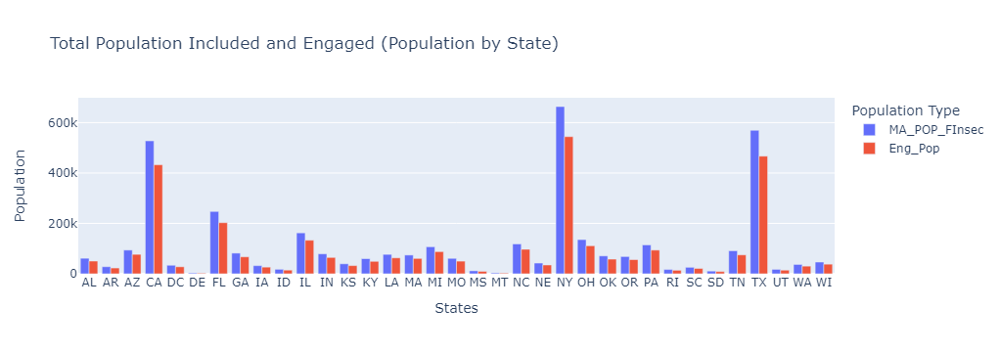

In [32]:
# Calculate the total MA_POP_FInsec and total Eng_Pop for each state
state_totals = cdc_fda_main_deploy.groupby('StateAbbr').agg({'MA_POP_FInsec': 'sum','Eng_Pop': 'sum'}).reset_index()

# Create a bar chart to visualize the total MA_POP_FInsec and total Eng_Pop for each state
fig = px.bar(state_totals, x='StateAbbr', y=['MA_POP_FInsec', 'Eng_Pop'],
             title='Total Population Included and Engaged (Population by State)',
             labels={'value': 'Population', 'variable': 'Population Type', 'StateAbbr': 'States'},
             barmode='group')

# Display the chart
fig.show()

<div style="text-align: justify">In the above visualization, we can observe two distinct populations in relation to the Food Access Program. The blue color represents the population that will be included in the program, while the red color represents the population that has the potential to engage with the program. This differentiation allows us to visually understand the overlap and distinction between the two groups, providing valuable insights into program coverage and potential reach.</div>

<h1><center>Which subgroup of the population might benefit the most from the program?</center></h1>

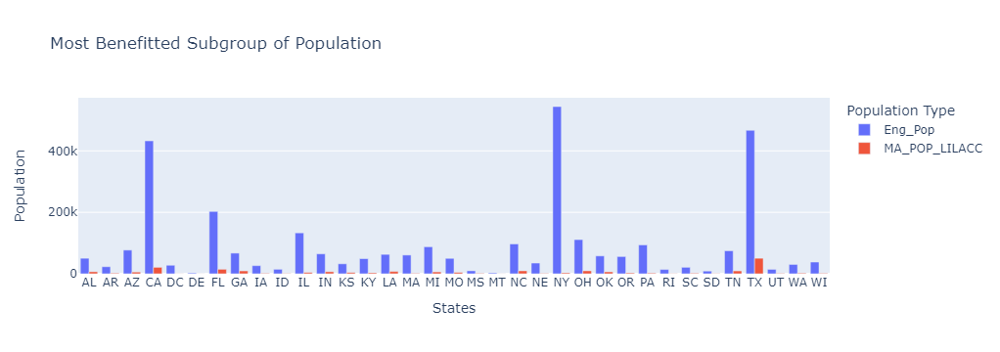

In [33]:
# Calculate the total MA_POP_FInsec and total Eng_Pop for each state
state_totals = cdc_fda_main_deploy.groupby('StateAbbr').agg({'Eng_Pop': 'sum', 'MA_POP_LILACC': 'sum'}).reset_index()

# Create a bar chart to visualize the total MA_POP_FInsec and total Eng_Pop for each state
fig = px.bar(state_totals, x='StateAbbr', y=['Eng_Pop', 'MA_POP_LILACC'],
             title='Most Benefitted Subgroup of Population ',
             labels={'value': 'Population', 'variable': 'Population Type', 'StateAbbr': 'States'},
             barmode='group')

# Display the chart
fig.show()

<div style="text-align: justify">In the above visualization, the red color represents a specific segment of the engaged population that would benefit the most from the food access program. This segment comprises individuals who exceed the national poverty rate and face food insecurity. Furthermore, this population subset also includes individuals with low income levels and limited access to stores. By highlighting this group, we can identify and prioritize the individuals who are most in need of support and intervention from the food access program, addressing their specific challenges related to poverty, food insecurity, and limited access to stores.</div>

<h1><center>What is the projected impact of this program? </center></h1>

To assess the success of the Food Access Program, we will focus on three key factors:
- Food Insecurity
- Low Access to Stores
- Poverty Rate

Our objective is to estimate the percentage decrease in these factors for each state following the successful deployment of the program.

Features Created:
- `FOODINSEC_Pop`: % Food insecure population by state 
- `LACCESS_Pop`: % Population which has low access to stores
- `POV_Pop`: % Population living in poverty
- `FOODINSE_Ben_Pop`: Population with food insecurity after the deployent of Food Access Program
- `LACCESS_Ben_Pop`: Population with low access to stores after the deployent of Food Access Program
- `POV_Ben_Pop`: Population living in poverty after the deployent of Food Access Program
- `Proj_FOODINSEC`: % Projected poverty rate by states after successful deployent of Food Access Program
- `Proj_LACCESS`: % Projected percentage of poluation with low access to store after successful deployent of Food Access Program
- `Proj_POV`: % Projected Population living in poverty after successful deployent of Food Access Program

In [34]:
# Create temporary dataset
cdc_fda_prj_imp = cdc_fda_main_deploy[['StateAbbr', 'FOODINSEC_15_17', 'PCT_LACCESS_POP15', 'POVRATE15', 'Population2017', 'Eng_Pop']]

grouped_cdc_fda_prj_imp = cdc_fda_prj_imp.groupby('StateAbbr').agg({'Population2017': 'sum','FOODINSEC_15_17': 'mean','PCT_LACCESS_POP15': 'mean','POVRATE15': 'mean', 'Eng_Pop' : 'sum'}).reset_index()

# Create necessary columns 
grouped_cdc_fda_prj_imp['FOODINSEC_Pop'] = (grouped_cdc_fda_prj_imp['Population2017']*(grouped_cdc_fda_prj_imp['FOODINSEC_15_17']/100)).astype(int)
grouped_cdc_fda_prj_imp['LACCESS_Pop'] = (grouped_cdc_fda_prj_imp['Population2017']*(grouped_cdc_fda_prj_imp['PCT_LACCESS_POP15']/100)).astype(int)
grouped_cdc_fda_prj_imp['POV_Pop'] = (grouped_cdc_fda_prj_imp['Population2017']*(grouped_cdc_fda_prj_imp['POVRATE15']/100)).astype(int)

grouped_cdc_fda_prj_imp['FOODINSE_Ben_Pop'] = (grouped_cdc_fda_prj_imp['FOODINSEC_Pop']- grouped_cdc_fda_prj_imp['Eng_Pop']).astype(int)
grouped_cdc_fda_prj_imp['LACCESS_Ben_Pop'] = (grouped_cdc_fda_prj_imp['LACCESS_Pop']- grouped_cdc_fda_prj_imp['Eng_Pop']).astype(int)
grouped_cdc_fda_prj_imp['POV_Ben_Pop'] = (grouped_cdc_fda_prj_imp['POV_Pop']- grouped_cdc_fda_prj_imp['Eng_Pop']).astype(int)

grouped_cdc_fda_prj_imp['Proj_FOODINSEC'] = (grouped_cdc_fda_prj_imp['FOODINSE_Ben_Pop']/grouped_cdc_fda_prj_imp['Population2017'])*100
grouped_cdc_fda_prj_imp['Proj_LACCESS'] = (grouped_cdc_fda_prj_imp['LACCESS_Ben_Pop']/grouped_cdc_fda_prj_imp['Population2017'])*100
grouped_cdc_fda_prj_imp['Proj_POV'] = (grouped_cdc_fda_prj_imp['POV_Ben_Pop']/grouped_cdc_fda_prj_imp['Population2017'])*100

In [35]:
grouped_cdc_fda_prj_imp['FOODINSEC_15_17'].mean() - grouped_cdc_fda_prj_imp['Proj_FOODINSEC'].mean(), grouped_cdc_fda_prj_imp['PCT_LACCESS_POP15'].mean() - grouped_cdc_fda_prj_imp['Proj_LACCESS'].mean(), grouped_cdc_fda_prj_imp['POVRATE15'].mean() - grouped_cdc_fda_prj_imp['Proj_POV'].mean()

(4.3679046721273735, 4.367881441510681, 4.367932977411778)

From the above analysis, the following changes are evident after the successful deployment of the Food Access Program in the targeted regions:

- Approximately `4.3679046721273735%` decrease in `Food Insecurity`
- Approximately `4.367881441510681%` decrease in `Population with Low Access to Stores`
- Approximately `4.367932977411778%` decrease in `Poverty Rate`

<h1><center>Appendix</center></h1>

## Vizualization 1: Food Insecurity Percentage by States

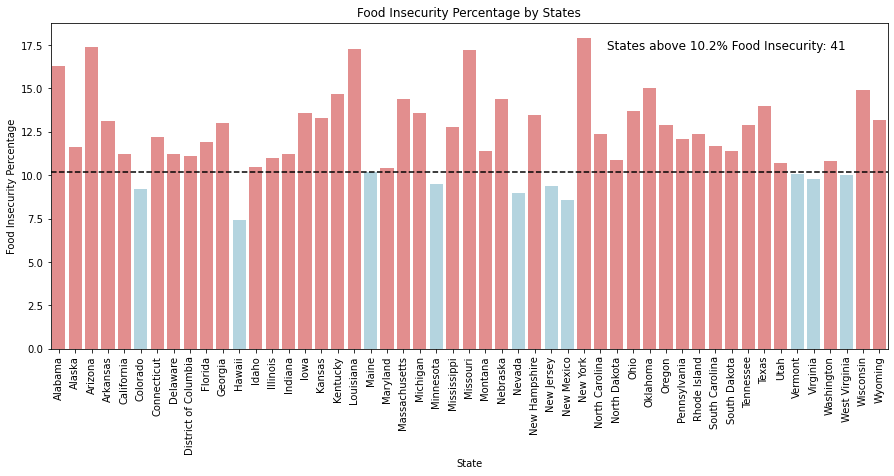

In [36]:
# Create Temporary Dataset
food_insecurity_state = insecurity[['FIPS', 'State', 'FOODINSEC_12_14', 'FOODINSEC_15_17', 'VLFOODSEC_12_14', 'VLFOODSEC_15_17' ]].copy()
food_insecurity_state['FIPS'] = food_insecurity_state['FIPS'].str[:2].str.lstrip('0').astype(int)


# Group by 'State' and calculate the mean food insecurity value for each state
food_insecurity_state_grp= pd.DataFrame(food_insecurity_state.groupby(['FIPS','State'])[['FOODINSEC_12_14','FOODINSEC_15_17', 'VLFOODSEC_12_14', 'VLFOODSEC_15_17']].mean().reset_index())
food_insecurity_state_grp.rename(columns={'FIPS': 'StateFIPS'}, inplace=True) # rename FIPS to StateFIPS


# Perform a left merge on a common column between food_insecurity_state_grp and state_data
food_insec_merged = food_insecurity_state_grp.merge(state_data[['StateFIPS', 'State', 'State_Population_2014', 'State_Population_2017']], on='StateFIPS', how='left')
food_insec_merged = food_insec_merged.drop('State_x', axis=1)
food_insec_merged.rename(columns={'State_y': 'State'}, inplace=True)


# Create new columns - FoodInPop_2014, FoodInPop_2017, VLFoodSecPop_2014, VLFoodSecPop_2017
food_insec_merged['FoodInPop_2014'] = (food_insec_merged['FOODINSEC_12_14']/100) * food_insec_merged['State_Population_2014']
food_insec_merged['FoodInPop_2017'] = (food_insec_merged['FOODINSEC_15_17']/100) * food_insec_merged['State_Population_2017']
food_insec_merged['VLFoodSecPop_2014'] = (food_insec_merged['VLFOODSEC_12_14']/100) * food_insec_merged['State_Population_2014']
food_insec_merged['VLFoodSecPop_2017'] = (food_insec_merged['VLFOODSEC_15_17']/100) * food_insec_merged['State_Population_2017']

plt.figure(figsize=(15, 6))

# Set the color palette
colors = ['lightblue' if val <= 10.2 else 'lightcoral' for val in food_insec_merged['FOODINSEC_15_17']]

# Create the bar plot with custom colors
ax = sns.barplot(data=food_insec_merged, x='State', y='FOODINSEC_15_17', palette=colors)

plt.xlabel('State')
plt.ylabel('Food Insecurity Percentage')
plt.title('Food Insecurity Percentage by States')
plt.xticks(rotation=90)

# Add a horizontal line at 10.2%
plt.axhline(y=10.2, color='black', linestyle='--')

# Count states above 10.2%
count_above_10_2 = (food_insec_merged['FOODINSEC_15_17'] > 10.2).sum()

# Add count text to the plot
ax.text(0.95, 0.95, f"States above 10.2% Food Insecurity: {count_above_10_2}",transform=ax.transAxes, ha='right', va='top', fontsize=12)

plt.show()

<div style="text-align: justify">Among the 51 states in the United States of America, it's alarming to discover that a substantial 41 states have a food insecurity percentage exceeding 10.2%. This is higher than the national average and demands our immediate attention. It's evident that these states are in dire need of assistance in combating food insecurity.</div>
<br>
<div style="text-align: justify">Therefore, our further analysis will specifically focus on these states, aiming to take swift action, such as implementing a food access program, to address this pressing issue. By prioritizing these states, we can effectively work towards mitigating food insecurity and improving the well-being of the affected communities.</div>

## Vizualization 2 :Comparison of Food Insecure Population for each State (2014 vs 2017)

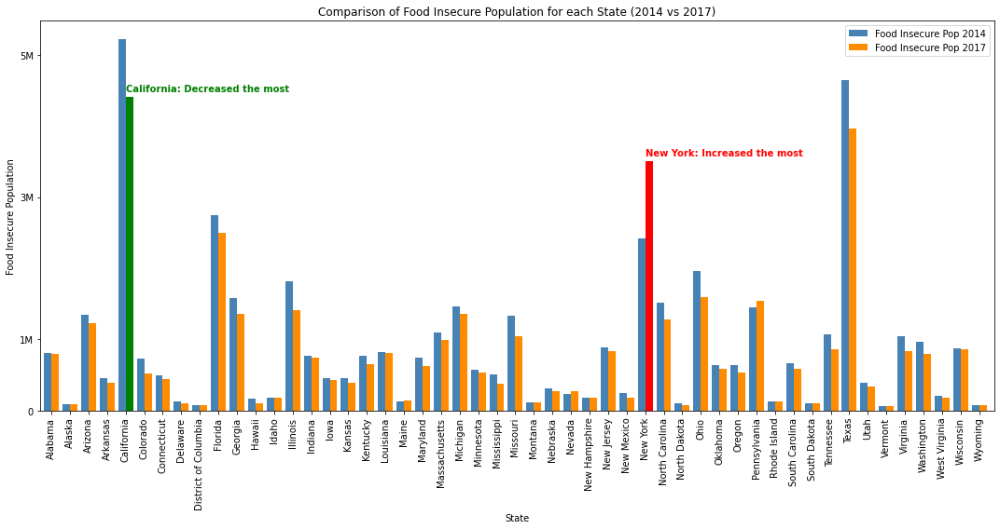

In [37]:
# Set the width of each bar
bar_width = 0.4

# Set the x-axis values as state names
x = np.arange(len(food_insec_merged['State']))

# Create subplots with two bars for each state
fig, ax = plt.subplots(figsize=(15, 8))

# Calculate the difference in food insecurity population from 2014 to 2017
difference = food_insec_merged['FoodInPop_2017'] - food_insec_merged['FoodInPop_2014']

# Find the state with the biggest decrease
state_with_biggest_decrease = food_insec_merged.loc[difference == difference.min(), 'State'].values[0]

# Find the state with the biggest increase
state_with_biggest_increase = food_insec_merged.loc[difference == difference.max(), 'State'].values[0]

# Set the colors for highlighting the states
decrease_color = 'green'
increase_color = 'red'

# Plot the data for 2014
ax.bar(x - bar_width/2, food_insec_merged['FoodInPop_2014'], width=bar_width, align='center', label='Food Insecure Pop 2014', color='steelblue')

# Plot the data for 2017
ax.bar(x + bar_width/2, food_insec_merged['FoodInPop_2017'], width=bar_width, align='center', label='Food Insecure Pop 2017', color='darkorange')

# Highlight the state with the biggest decrease
highlight_index_decrease = np.where(food_insec_merged['State'] == state_with_biggest_decrease)[0][0]
ax.bar(x[highlight_index_decrease] + bar_width/2, food_insec_merged['FoodInPop_2017'][highlight_index_decrease], width=bar_width, align='center', color=decrease_color)

# Highlight the state with the biggest increase
highlight_index_increase = np.where(food_insec_merged['State'] == state_with_biggest_increase)[0][0]
ax.bar(x[highlight_index_increase] + bar_width/2, food_insec_merged['FoodInPop_2017'][highlight_index_increase], width=bar_width, align='center', color=increase_color)



# Add annotations for the states with the biggest decrease and increase
decrease_annotation = f"{state_with_biggest_decrease}: Decreased the most"
increase_annotation = f"{state_with_biggest_increase}: Increased the most"
ax.annotate(decrease_annotation, xy=(highlight_index_decrease, food_insec_merged['FoodInPop_2017'][highlight_index_decrease]),xytext=(highlight_index_decrease, food_insec_merged['FoodInPop_2017'][highlight_index_decrease] + 50000),ha='left', va='bottom', color=decrease_color, weight='bold')
ax.annotate(increase_annotation, xy=(highlight_index_increase, food_insec_merged['FoodInPop_2017'][highlight_index_increase]),xytext=(highlight_index_increase, food_insec_merged['FoodInPop_2017'][highlight_index_increase] + 50000),ha='left', va='bottom', color=increase_color, weight='bold')

# Set x-axis ticks and labels
ax.set_xticks(x)
ax.set_xticklabels(food_insec_merged['State'])
ax.tick_params(axis='x', rotation=90)

# Add labels and title
ax.set_xlabel('State')
ax.set_ylabel('Food Insecure Population')
ax.set_title('Comparison of Food Insecure Population for each State (2014 vs 2017)')

# Adjust the spacing between bars
ax.set_xlim(-0.6, len(food_insec_merged['State']) - 0.2)

# Set the Y-axis tick values and labels
yticks = [0, 1000000, 3000000, 5000000]  # Specify the desired tick values
yticklabels = ['0', '1M', '3M', '5M']  # Specify the desired tick labels
plt.yticks(yticks, yticklabels)

# Add legend
ax.legend()

# Show the plot
plt.tight_layout()
plt.show()

<div style="text-align: justify">An intriguing observation arises when comparing the trends between 2014 and 2017. During this period, California managed to make remarkable progress by significantly reducing its food insecure population. On the other hand, New York experienced an unfortunate increase in food insecurity. These divergent outcomes highlight the importance of understanding and addressing the unique challenges faced by different states.</div>

According to the Food Research and Action Centre, nationwide, approximately `24%` of older adults participate in Food Benefit programs.

- In New York, a state with relatively high participation rate, `70%` of eligible older adults take advantage of food aid.
- In California, a mere `19%` of eligible adults take advantsge of the aid

<div style="text-align: justify">It is noteworthy that despite California having a relatively lower food aid participation rate of 19%, the state has successfully reduced its food insecurity population between 2014 and 2017. This highlights the complexity of the food insecurity issue and reminds us that addressing it requires a multifaceted approach.</div>

### Sources used throughout the analysis:

- https://www.ers.usda.gov/data-products/food-environment-atlas/data-access-and-documentation-downloads/
- https://chronicdata.cdc.gov/500-Cities-Places/500-Cities-Census-Tract-level-Data-GIS-Friendly-Fo/k86t-wghb
- https://www.census.gov/library/publications/2022/demo/p60-277.html
- https://www.fns.usda.gov/usamap#
- https://www.kff.org/medicare/issue-brief/medicare-advantage-in-2022-enrollment-update-and-key-trends/
- https://www.ers.usda.gov/data-products/ag-and-food-statistics-charting-the-essentials/food-security-and-nutrition-assistance/#:~:text=In%202021%2C%2089.8%20percent%20of,had%20very%20low%20food%20security.

In [38]:
# Rough work

In [39]:
cdc_fda_main_deploy_filtered

,StateAbbr,MA_POP,MA_POP_LILACC,Geolocation,latitude,longitude
0,AL,1105.33248,22.109626,"(33.57943283260, -86.7228323926)",33.579433,-86.722832
1,AL,915.04512,18.303366,"(33.54282086860, -86.7524339780)",33.542821,-86.752434
2,AL,1208.29392,24.169132,"(33.56324496330, -86.7640474064)",33.563245,-86.764047
3,AL,1029.72672,20.597307,"(33.54424045940, -86.7749130719)",33.544240,-86.774913
4,AL,879.60480,17.594465,"(33.55254061390, -86.8016893706)",33.552541,-86.801689
...,...,...,...,...,...,...
23139,WI,1516.08672,18.806766,"(42.75107563540, -87.7941677487)",42.751076,-87.794168
23140,WI,1621.79712,20.118083,"(42.74714848740, -87.7808983411)",42.747148,-87.780898
23141,WI,2808.33216,34.836824,"(42.76307854130, -87.7841370268)",42.763079,-87.784137
23142,WI,342.31104,4.246303,"(42.77180149710, -87.7900502133)",42.771801,-87.790050


In [43]:
state_counts = cdc_fda_main_deploy_filtered.groupby('StateAbbr')['Geolocation'].nunique().reset_index(name='Count')

In [44]:
state_counts

,StateAbbr,Count
0,AL,332
1,AR,114
2,AZ,344
3,CA,2413
4,DC,178
...,...,...
30,TN,486
31,TX,2579
32,UT,88
33,WA,185


In [46]:
state_counts.to_excel(r'state_counts.xlsx', index=False)

In [50]:
state_counts_1 = cdc_data_final.groupby('StateAbbr')['Geolocation'].nunique().reset_index(name='Count')

In [51]:
state_counts_1

,StateAbbr,Count
0,AK,55
1,AL,345
2,AR,118
3,AZ,1000
4,CA,5239
...,...,...
46,VT,11
47,WA,503
48,WI,400
49,WV,22


In [52]:
merged_df = pd.merge(state_counts, state_counts_1, on='StateAbbr')

In [53]:
merged_df

,StateAbbr,Count_x,Count_y
0,AL,332,345
1,AR,114,118
2,AZ,344,1000
3,CA,2413,5239
4,DC,178,178
...,...,...,...
30,TN,486,511
31,TX,2579,2961
32,UT,88,233
33,WA,185,503


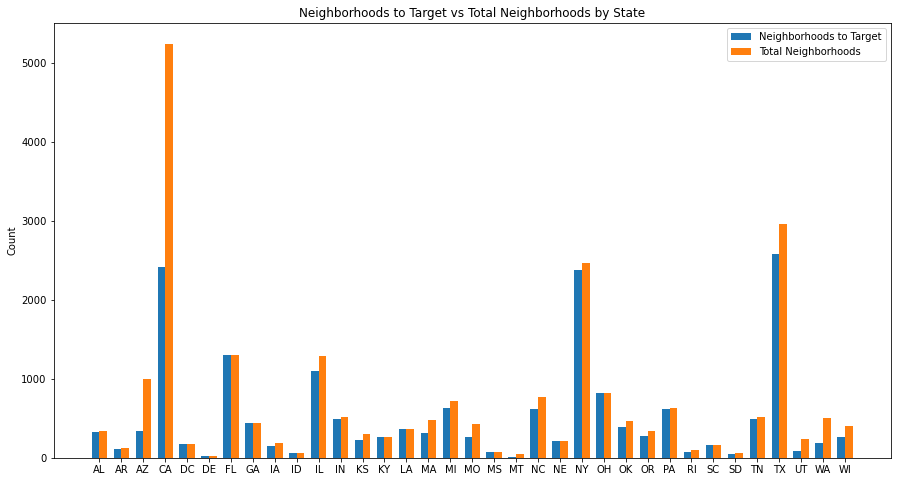

In [57]:
# Set the position of the bars on the x-axis
x = range(len(merged_df))

fig, ax = plt.subplots(figsize=(15, 8))

# Set the position of the bars on the x-axis
x = np.arange(len(merged_df))
bar_width = 0.35

# Plotting the bars side by side
plt.bar(x, merged_df['Count_x'], width=bar_width, align='center', label='Neighborhoods to Target')
plt.bar(x + bar_width, merged_df['Count_y'], width=bar_width, align='center', label='Total Neighborhoods')

# Labeling the x-axis with State Abbreviations
plt.xticks(x + bar_width/2, merged_df['StateAbbr'])

# Labeling the y-axis and title
plt.ylabel('Count')
plt.title('Neighborhoods to Target vs Total Neighborhoods by State')

# Adding a legend
plt.legend()

# Displaying the plot
plt.show()

In [60]:
state_totals.Eng_Pop.sum()

3143454.1836947617

In [64]:
len(cdc_fda_main_deploy.PlaceName.unique())

303

In [72]:
cdc_fda_main_deploy.MA_POP_FInsec.sum().astype(int)

3833480

In [74]:
cdc_fda_main_deploy.Eng_Pop.sum().astype(int)

3143454

In [73]:
cdc_fda_main_deploy.MA_POP.sum().astype(int)

28365718

In [75]:
cdc_fda_main_deploy.MA_POP_LILACC.sum().astype(int)

205035